<a href="https://colab.research.google.com/github/mohammed21kamall/Graduation-Project/blob/main/Model%20AI/SimilarityOfAllUsers.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
ratings = pd.read_csv("drive/MyDrive/Dataset2/ratings.csv")
movies = pd.read_csv("drive/MyDrive/Dataset2/movies.csv")

In [4]:
movies_ratings = pd.merge(ratings, movies, on="movieId")

In [5]:
movies_ratings.head()

,userId,movieId,rating,timestamp,title,genres
0,1,1,4.0,964982703,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy
1,5,1,4.0,847434962,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy
2,7,1,4.5,1106635946,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy
3,15,1,2.5,1510577970,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy
4,17,1,4.5,1305696483,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy


In [6]:
movies_ratings = movies_ratings[['userId', 'movieId', 'genres', 'rating']]

In [7]:
movies_ratings.head()

,userId,movieId,genres,rating
0,1,1,Adventure|Animation|Children|Comedy|Fantasy,4.0
1,5,1,Adventure|Animation|Children|Comedy|Fantasy,4.0
2,7,1,Adventure|Animation|Children|Comedy|Fantasy,4.5
3,15,1,Adventure|Animation|Children|Comedy|Fantasy,2.5
4,17,1,Adventure|Animation|Children|Comedy|Fantasy,4.5


In [8]:
movies_ratings = movies_ratings.sort_values(by='userId', ascending=True)

In [9]:
movies_ratings.head()

,userId,movieId,genres,rating
0,1,1,Adventure|Animation|Children|Comedy|Fantasy,4.0
12117,1,2389,Crime|Horror|Thriller,2.0
12126,1,2395,Comedy|Drama,5.0
12182,1,2406,Action|Adventure|Comedy|Romance,4.0
776,1,70,Action|Comedy|Horror|Thriller,3.0


In [10]:
movies_ratings['genres'] = movies_ratings['genres'].str.split('|')
movies_ratings.head()

,userId,movieId,genres,rating
0,1,1,"[Adventure, Animation, Children, Comedy, Fantasy]",4.0
12117,1,2389,"[Crime, Horror, Thriller]",2.0
12126,1,2395,"[Comedy, Drama]",5.0
12182,1,2406,"[Action, Adventure, Comedy, Romance]",4.0
776,1,70,"[Action, Comedy, Horror, Thriller]",3.0


In [11]:
n_movies = movies_ratings['movieId'].nunique()
n_users = movies_ratings['userId'].nunique()

print(f"Number of unique movieId's: {n_movies}")
print(f"Number of unique users: {n_users}")

Number of unique movieId's: 9724
Number of unique users: 610


In [12]:
movie_stats = ratings.groupby('userId')['movieId'].agg(['count'])
movie_stats.head()

,count
userId,
1,232
2,29
3,39
4,216
5,44


In [13]:
# قم بتحويل البيانات إلى قاموس
user_movie_dict = {}

for user_id, count_for_user in movie_stats.iterrows():
    user_movie_dict[user_id] = count_for_user['count']

# طباعة النتائج لجميع المستخدمين
for user_id, count_for_user in user_movie_dict.items():
    print(f"The count for user {user_id} is: {count_for_user}")

The count for user 1 is: 232
The count for user 2 is: 29
The count for user 3 is: 39
The count for user 4 is: 216
The count for user 5 is: 44
The count for user 6 is: 314
The count for user 7 is: 152
The count for user 8 is: 47
The count for user 9 is: 46
The count for user 10 is: 140
The count for user 11 is: 64
The count for user 12 is: 32
The count for user 13 is: 31
The count for user 14 is: 48
The count for user 15 is: 135
The count for user 16 is: 98
The count for user 17 is: 105
The count for user 18 is: 502
The count for user 19 is: 703
The count for user 20 is: 242
The count for user 21 is: 443
The count for user 22 is: 119
The count for user 23 is: 121
The count for user 24 is: 110
The count for user 25 is: 26
The count for user 26 is: 21
The count for user 27 is: 135
The count for user 28 is: 570
The count for user 29 is: 81
The count for user 30 is: 34
The count for user 31 is: 50
The count for user 32 is: 102
The count for user 33 is: 156
The count for user 34 is: 86
The c

In [14]:
# تفجير القائمة في عمود 'genres'
exploded_ratings = movies_ratings.explode('genres')

# استخدام groupby لتجميع البيانات بناءً على 'userId' و 'genres'، ثم حساب حجم كل مجموعة
user_genre_counts = exploded_ratings.groupby(['userId', 'genres']).size().reset_index(name='No.Of Frequency')

# طباعة النتائج
user_genre_counts.head()


,userId,genres,No.Of Frequency
0,1,Action,90
1,1,Adventure,85
2,1,Animation,29
3,1,Children,42
4,1,Comedy,83


In [15]:
from collections import Counter

genre_frequency = Counter(g for genres in movies_ratings['genres'] for g in genres)

print(f"There are {len(genre_frequency)} genres.")

genre_frequency

There are 20 genres.


Counter({'Adventure': 24161,
         'Animation': 6988,
         'Children': 9208,
         'Comedy': 39053,
         'Fantasy': 11834,
         'Crime': 16681,
         'Horror': 7291,
         'Thriller': 26452,
         'Drama': 41928,
         'Action': 30635,
         'Romance': 18124,
         'Mystery': 7674,
         'War': 4859,
         'Sci-Fi': 17243,
         'Western': 1930,
         'Musical': 4138,
         'Film-Noir': 870,
         'Documentary': 1219,
         'IMAX': 4145,
         '(no genres listed)': 47})

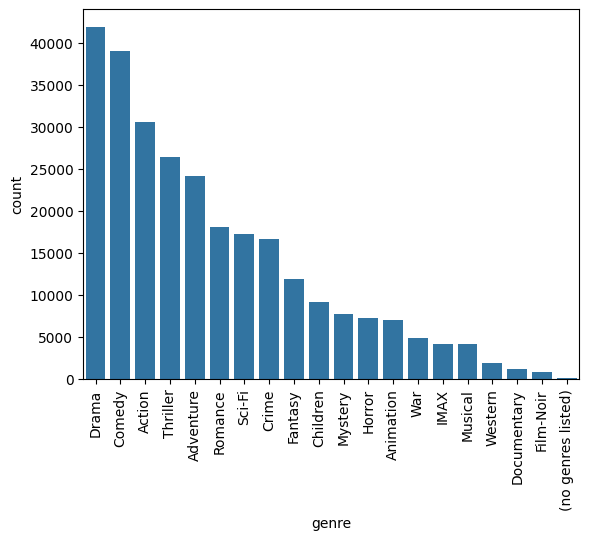

In [16]:
genre_frequency_df = pd.DataFrame([genre_frequency]).T.reset_index()
genre_frequency_df.columns = ['genre', 'count']

sns.barplot(x='genre', y='count', data=genre_frequency_df.sort_values(by='count', ascending=False))
plt.xticks(rotation=90)
plt.show()

In [17]:
# قم بتكوين القاموس لتخزين النتائج
user_genre_dict = {}

# قم بالتكرار على كل الـ genres الممكنة وكل المستخدمين
for user_id, genre, number_of_times in user_genre_counts.itertuples(index=False):
    # استخدم الزوج (user_id, genre) كمفتاح للقاموس و `No.Of Frequency` كقيمة.
    user_genre_dict[(user_id, genre)] = number_of_times

# طباعة النتائج في القاموس
for (user_id, genre), number_of_times in user_genre_dict.items():
    print(f"The No.Of Frequency for user '{user_id}' and genre '{genre}' is: [{number_of_times}]")

Streaming output truncated to the last 5000 lines.
The No.Of Frequency for user '306' and genre 'Western' is: [2]
The No.Of Frequency for user '307' and genre 'Action' is: [159]
The No.Of Frequency for user '307' and genre 'Adventure' is: [153]
The No.Of Frequency for user '307' and genre 'Animation' is: [45]
The No.Of Frequency for user '307' and genre 'Children' is: [94]
The No.Of Frequency for user '307' and genre 'Comedy' is: [518]
The No.Of Frequency for user '307' and genre 'Crime' is: [140]
The No.Of Frequency for user '307' and genre 'Documentary' is: [5]
The No.Of Frequency for user '307' and genre 'Drama' is: [341]
The No.Of Frequency for user '307' and genre 'Fantasy' is: [107]
The No.Of Frequency for user '307' and genre 'Film-Noir' is: [5]
The No.Of Frequency for user '307' and genre 'Horror' is: [138]
The No.Of Frequency for user '307' and genre 'IMAX' is: [17]
The No.Of Frequency for user '307' and genre 'Musical' is: [48]
The No.Of Frequency for user '307' and genre 'My

In [18]:
def user_behavior_probability(total_movies, genre_label_count):
    user_behavior_prob = genre_label_count / total_movies
    return round(user_behavior_prob, 3)


In [19]:
# قم بتكوين القاموس لتخزين نتائج الاحتمالات لكل تصنيف (genre) لكل مستخدم
user_genre_probabilities = []

for user_id, genre, genre_count in user_genre_counts.itertuples(index=False):
    # احتمال تصنيف المستخدم للتصنيف (genre) الحالي
    probability = user_behavior_probability(user_movie_dict[user_id], genre_count)

    # استخدم الزوج (user_id, genre) كمفتاح للقاموس والاحتمال كقيمة
    user_genre_probabilities.append({'User_ID': user_id, 'Genre': genre, 'Probability': probability})

# تحويل النتائج إلى DataFrame
results_df = pd.DataFrame(user_genre_probabilities)

# استخدم pivot لتحويل البيانات إلى الشكل المطلوب
User_Behavior_Probability = results_df.pivot(index='User_ID', columns='Genre', values='Probability')

# استخدام fillna لتعويض القيم الفارغة بصفر (إذا لزم الأمر)
User_Behavior_Probability.fillna(0, inplace=True)

# ضبط إعدادات pandas لعرض جميع الصفوف والأعمدة
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

User_Behavior_Probability.head()

Genre,(no genres listed),Action,Adventure,Animation,Children,Comedy,Crime,Documentary,Drama,Fantasy,Film-Noir,Horror,IMAX,Musical,Mystery,Romance,Sci-Fi,Thriller,War,Western
User_ID,,,,,,,,,,,,,,,,,,,,
1,0.0,0.388,0.366,0.125,0.181,0.358,0.194,0.000,0.293,0.203,0.004,0.073,0.000,0.095,0.078,0.112,0.172,0.237,0.095,0.030
2,0.0,0.379,0.103,0.000,0.000,0.241,0.345,0.103,0.586,0.000,0.000,0.034,0.138,0.000,0.069,0.034,0.138,0.345,0.034,0.034
3,0.0,0.359,0.282,0.103,0.128,0.231,0.051,0.000,0.410,0.103,0.000,0.205,0.000,0.026,0.026,0.128,0.385,0.179,0.128,0.000
4,0.0,0.116,0.134,0.028,0.046,0.481,0.125,0.009,0.556,0.088,0.019,0.019,0.005,0.074,0.106,0.269,0.056,0.176,0.032,0.046
5,0.0,0.205,0.182,0.136,0.205,0.341,0.273,0.000,0.568,0.159,0.000,0.023,0.068,0.114,0.023,0.250,0.045,0.205,0.068,0.045


In [20]:

# قاموس لتخزين الاحتماليات لكل مستخدم وتصنيف
user_genre_probabilities_dict = {}

# iterate over each row (user) in the pivot_results DataFrame
for user_id, row in User_Behavior_Probability.iterrows():
    # iterate over each column (genre) in the row
    for genre_name, user_genre_probability in row.items():
        # تخزين الاحتمالية في القاموس
        user_genre_probabilities_dict[(user_id, genre_name)] = user_genre_probability

# إنشاء DataFrame لتخزين متوسط احتماليات كل مستخدم
user_mean_df = pd.DataFrame(index=User_Behavior_Probability.index, columns=['Mean_Probability'])

# حساب متوسط احتماليات كل مستخدم وتخزينه في DataFrame
for user_id in User_Behavior_Probability.index:
    user_probabilities = [user_genre_probabilities_dict[(user_id, genre_name)] for genre_name in User_Behavior_Probability.columns]
    mean_probability = np.mean(user_probabilities)

    # تخزين النتيجة في DataFrame
    user_mean_df.loc[user_id] = [mean_probability]

# طباعة DataFrame النتائج
user_mean_df.head()

,Mean_Probability
User_ID,
1,0.1502
2,0.12915
3,0.1372
4,0.11925
5,0.1455


In [21]:
# 1

# قاموس لتخزين الاحتماليات لكل مستخدم وتصنيف
user_genre_probabilities_dict = {}

# iterate over each row (user) in the pivot_results DataFrame
for user_id, row in User_Behavior_Probability.iterrows():
    # iterate over each column (genre) in the row
    for genre_name, user_genre_probability in row.items():
        # تخزين الاحتمالية في القاموس
        user_genre_probabilities_dict[(user_id, genre_name)] = user_genre_probability

# إنشاء DataFrame لتخزين متوسط احتماليات كل مستخدم
PCC_Probability = pd.DataFrame(index=User_Behavior_Probability.index, columns=User_Behavior_Probability.index)

# حساب متوسط احتماليات كل مستخدم وتخزينه في DataFrame
for user_id1 in User_Behavior_Probability.index:
    for user_id2 in User_Behavior_Probability.index:
        # استخدام معادلة معامل بيرسون لحساب الشبه بين المستخدمين
        user1_probabilities = [user_genre_probabilities_dict[(user_id1, genre_name)] for genre_name in User_Behavior_Probability.columns]
        user2_probabilities = [user_genre_probabilities_dict[(user_id2, genre_name)] for genre_name in User_Behavior_Probability.columns]

        U1_mean = np.mean(user1_probabilities)
        U2_mean = np.mean(user2_probabilities)

        numerator = np.sum((np.array(user1_probabilities) - U1_mean) * (np.array(user2_probabilities) - U2_mean))
        denominator_U1 = np.sqrt(np.sum((np.array(user1_probabilities) - U1_mean)**2))
        denominator_U2 = np.sqrt(np.sum((np.array(user2_probabilities) - U2_mean)**2))

        PCC_UV = numerator / (denominator_U1 * denominator_U2)

        # تخزين النتيجة في DataFrame
        PCC_Probability.loc[user_id1, user_id2] = PCC_UV

# طباعة DataFrame النتائج
PCC_Probability.head()

User_ID,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610
User_ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1,1.0,0.613272,0.781623,0.622256,0.714236,0.765052,0.928886,0.788476,0.759237,0.573083,0.755483,0.423484,0.747465,0.706833,0.817912,0.787312,0.836655,0.870749,0.800854,0.737547,0.919846,0.757102,0.609295,0.859799,0.769707,0.713637,0.855792,0.693957,0.653384,0.704827,0.863176,0.795542,0.500679,0.875739,0.664221,0.787025,0.881712,0.745192,0.895424,0.805313,0.672604,0.80066,0.900935,0.907835,0.870606,0.873338,0.440961,0.768088,0.651313,0.889028,0.842072,0.844215,0.555828,0.768162,0.807454,0.857144,0.918504,0.771149,0.686614,0.560135,0.612609,0.86375,0.952789,0.820232,0.628467,0.856555,0.952209,0.871996,0.735605,0.476873,0.861449,0.753257,0.85262,0.413813,0.769399,0.848117,0.758764,0.875365,0.809894,0.524793,0.871567,0.923185,0.734359,0.560205,0.351478,0.879295,0.722226,0.65678,0.570232,0.488419,0.882782,0.781545,0.914235,0.91214,0.838631,0.896581,0.884973,0.870189,0.790207,0.546285,0.808118,0.809816,0.86047,0.704945,0.789844,0.687954,0.890162,0.509132,0.753941,0.705127,0.699125,0.863374,0.400426,0.754511,0.91065,0.818802,0.841092

In [22]:
# البيانات الأصلية
df = pd.DataFrame(movies_ratings)

# قائمة بالمستخدمين الفريدة
users = df['userId'].unique()

# إعداد الجدول
common_data = []

# حلقة لبناء البيانات
for user1 in users:
    row_data = []
    for user2 in users:
        if user1 == user2:
            # عندما يكون المستخدم هو نفسه، يمكنك تعيين قيمة معينة (مثل 0) أو تركها فارغة
            row_data.append(None)
        else:
            pair = tuple(sorted([user1, user2]))
            common_movies = len(pd.merge(df[df['userId'] == user1]['movieId'], df[df['userId'] == user2]['movieId'], on='movieId'))
            row_data.append(common_movies)

    common_data.append(row_data)
# تحويل البيانات إلى DataFrame وتعديل القيم NaN إلى 0
common_m = pd.DataFrame(common_data, index=users, columns=users).fillna(1)
common_m.head()


,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610
1,1.0,2.0,7.0,45.0,13.0,33.0,26.0,15.0,5.0,6.0,16.0,2.0,6.0,13.0,25.0,26.0,38.0,70.0,123.0,33.0,47.0,7.0,17.0,25.0,7.0,7.0,46.0,73.0,20.0,8.0,17.0,22.0,27.0,15.0,6.0,10.0,11.0,19.0,51.0,16.0,27.0,79.0,22.0,13.0,100.0,11.0,13.0,9.0,7.0,25.0,40.0,8.0,4.0,12.0,6.0,14.0,112.0,26.0,38.0,4.0,12.0,29.0,52.0,111.0,5.0,66.0,11.0,154.0,15.0,9.0,10.0,20.0,9.0,13.0,20.0,29.0,6.0,20.0,26.0,13.0,10.0,47.0,19.0,44.0,1.0,19.0,2.0,8.0,17.0,6.0,117.0,2.0,37.0,13.0,32.0,38.0,7.0,10.0,7.0,29.0,15.0,17.0,59.0,33.0,35.0,2.0,7.0,7.0,26.0,14.0,33.0,18.0,13.0,6.0,37.0,30.0,33.0,9.0,13.0,8.0,14.0,48.0,9.0,21.0,23.0,14.0,2.0,13.0,33.0,8.0,19.0,49.0,15.0,13.0,80.0,18.0,36.0,4.0,5.0,73.0,36.0,13.0,4.0,37.0,7.0,2.0,7.0,2.0,16.0,7.0,10.0,14.0,22.0,3.0,16.0,69.0,5.0,3.0,10.0,98.0,4.0,7.0,5.0,20.0,16.0,53.0,41.0,16.0,41.0,12.0,32.0,11.0,8.0,16.0,0.0,13.0,102.0,25.0,20.0,10.0,20.0,130.0,24.0,1.0,7.0,59.0,44.0,5.0,7.0,3.0,12.0,9.0,14.0,7.0,43.0,8.0,13.0,61.0,59.0,54.0,39.0,93.0,11.0,15.0,4.0,8.0,6.0,12.0,10.0,11.0,21.0,31.0,9.0,6.0,30.0,28.0,120.0,7.0,84.0,58.0,48.0,33.0,22.0,12.0,22.0,98.0,12.0,6.0,15.0,36.0,12.0,57.0,28.0,61.0,16.0,10.0,9.0,4.0,73.0,25.0,12.0,9.0,5.0,31.0,1.0,21.0,36.0,10.0,88.0,3.0,12.0,2.0,1.0,32.0,8.0,10.0,3.0,5.0,2.0,22.0,16.0,8.0,36.0,19.0,36.0,67.0,18.0,27.0,7.0,10.0,8.0,4.0,14.0,145.0,56.0,14.0,6.0,3.0,36.0,20.0,3.0,57.0,12.0,19.0,3.0,26.0,34.0,154.0,9.0,46.0,1.0,69.0,8.0,84.0,10.0,9.0,17.0,72.0,7.0,8.0,27.0,12.0,21.0,55.0,77.0,0.0,114.0,21.0,14.0,9.0,6.0,55.0,107.0,28.0,1.0,11.0,30.0,70.0,5.0,3.0,14.0,32.0,22.0,2.0,37.0,18.0,10.0,65.0,8.0,81.0,10.0,60.0,2.0,29.0,12.0,22.0,14.0,5.0,34.0,11.0,5.0,9.0,15.0,19.0,7.0,21.0,13.0,16.0,10.0,10.0,9.0,37.0,2

In [23]:
# 2


# تعريف القانون
def custom_function(value):
    if 0 <= value <= 5:
        return np.exp(-(5 - value))
    elif value > 5:
        return np.log(value - 5) + 1
    else:
        return 0




,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610
1,0.000000,0.049787,1.693147,4.688879,3.079442,4.332205,4.044522,3.302585,1.000000,1.000000,3.397895,0.049787,1.000000,3.079442,3.995732,4.044522,4.496508,5.174387,5.770685,4.332205,4.737670,1.693147,3.484907,3.995732,1.693147,1.693147,4.713572,5.219508,3.708050,2.098612,3.484907,3.833213,4.091042,3.302585,1.000000,2.609438,2.791759,3.639057,4.828641,3.397895,4.091042,5.304065,3.833213,3.079442,5.553877,2.791759,3.079442,2.386294,1.693147,3.995732,4.555348,2.098612,0.367879,2.945910,1.000000,3.197225,5.672829,4.044522,4.496508,0.367879,2.945910,4.178054,4.850148,5.663439,1.000000,5.110874,2.791759,6.003946,3.302585,2.386294,2.609438,3.708050,2.386294,3.079442,3.708050,4.178054,1.000000,3.708050,4.044522,3.079442,2.609438,4.737670,3.639057,4.663562,0.018316,3.639057,0.049787,2.098612,3.484907,1.000000,5.718499,0.049787,4.465736,3.079442,4.295837,4.496508,1.693147,2.609438,1.693147,4.178054,3.302585,3.484907,4.988984,4.332205,4.401197,0.049787,1.693147,1.693147,4.044522,3.197225,4.332205,3.564949,3.079442,1.000000,4.465736,4.218876,4.332205,2.386294,3.079442,2.098612,3.197225,4.761200,2.386294,3.772589,3.890372,3.197225,0.049787,3.079442,4.332205,2.098612,3.639057,4.784190,3.302585,3.079442,5.317488,3.564949,4.433987,0.367879,1.000000,5.219508,4.433987,3.079442,0.367879,4.465736,1.693147,0.049787,1.693147,0.049787,3.397895,1.693147,2.609438,3.197225,3.833213,0.135335,3.397895,5.158883,1.000000,0.135335,2.609438,5.532599,0.367879,1.693147,1.000000,3.708050,3.397895,4.871201,4.583519,3.397895,4.583519,2.945910,4.295837,2.791759,2.098612,3.397895,0.006738,3.079442,5.574711,3.995732,3.708050,2.609438,3.708050,5.828314,3.944439,0.018316,1.693147,

In [37]:
# استبدل custom_function بالدالة التي تريدها
def convert_zero_to_one(value):
    return 1 if value == 0 else value
# تطبيق الدالة المخصصة على القيم في الجدول
CONFIDENCE_COEFFICIENT = pd.DataFrame(common_data, index=users, columns=users).applymap(custom_function).applymap(convert_zero_to_one)
CONFIDENCE_COEFFICIENT.head()

,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610
1,1.000000,0.049787,1.693147,4.688879,3.079442,4.332205,4.044522,3.302585,1.000000,1.000000,3.397895,0.049787,1.000000,3.079442,3.995732,4.044522,4.496508,5.174387,5.770685,4.332205,4.737670,1.693147,3.484907,3.995732,1.693147,1.693147,4.713572,5.219508,3.708050,2.098612,3.484907,3.833213,4.091042,3.302585,1.000000,2.609438,2.791759,3.639057,4.828641,3.397895,4.091042,5.304065,3.833213,3.079442,5.553877,2.791759,3.079442,2.386294,1.693147,3.995732,4.555348,2.098612,0.367879,2.945910,1.000000,3.197225,5.672829,4.044522,4.496508,0.367879,2.945910,4.178054,4.850148,5.663439,1.000000,5.110874,2.791759,6.003946,3.302585,2.386294,2.609438,3.708050,2.386294,3.079442,3.708050,4.178054,1.000000,3.708050,4.044522,3.079442,2.609438,4.737670,3.639057,4.663562,0.018316,3.639057,0.049787,2.098612,3.484907,1.000000,5.718499,0.049787,4.465736,3.079442,4.295837,4.496508,1.693147,2.609438,1.693147,4.178054,3.302585,3.484907,4.988984,4.332205,4.401197,0.049787,1.693147,1.693147,4.044522,3.197225,4.332205,3.564949,3.079442,1.000000,4.465736,4.218876,4.332205,2.386294,3.079442,2.098612,3.197225,4.761200,2.386294,3.772589,3.890372,3.197225,0.049787,3.079442,4.332205,2.098612,3.639057,4.784190,3.302585,3.079442,5.317488,3.564949,4.433987,0.367879,1.000000,5.219508,4.433987,3.079442,0.367879,4.465736,1.693147,0.049787,1.693147,0.049787,3.397895,1.693147,2.609438,3.197225,3.833213,0.135335,3.397895,5.158883,1.000000,0.135335,2.609438,5.532599,0.367879,1.693147,1.000000,3.708050,3.397895,4.871201,4.583519,3.397895,4.583519,2.945910,4.295837,2.791759,2.098612,3.397895,0.006738,3.079442,5.574711,3.995732,3.708050,2.609438,3.708050,5.828314,3.944439,0.018316,1.693147,

In [26]:
# البيانات الأصلية
df = pd.DataFrame(movies_ratings)

# قائمة بالمستخدمين الفريدة
users = df['userId'].unique()

# إعداد الجدول
rate_user = []

# حلقة لبناء البيانات
for user in users:
    row_data = []
    for movie in df['movieId'].unique():
        rating = df[(df['userId'] == user) & (df['movieId'] == movie)]['rating'].values
        if len(rating) > 0:
            row_data.append(rating[0])
        else:
            row_data.append(None)

    rate_user.append(row_data)

# تحويل البيانات إلى DataFrame
table_rate = pd.DataFrame(rate_user, index=users, columns=df['movieId'].unique()).fillna(0)
table_rate.head()

,1,2389,2395,2406,70,2414,2427,2450,2459,2470,2478,2492,2387,2502,2529,2542,2571,2580,2596,2616,2617,2628,2640,2641,2644,2528,2366,2353,2338,2046,2048,2054,2058,2078,2090,2093,2094,2096,2099,2105,2115,2116,2137,2139,2141,2143,2161,2174,2193,2253,2268,2273,2291,2329,2648,2654,2657,2692,3253,3273,3386,3439,3440,3441,3448,3450,3479,3489,3527,3578,3617,3639,3671,3702,3703,3729,3740,3744,3793,3809,4006,5060,50,3247,2033,3243,3168,2700,2716,2761,2797,2826,2858,2872,2899,2916,2944,2947,2948,2949,2959,2985,2987,2991,2993,2997,3033,3034,3052,3053,3062,3147,3176,2028,2018,2012,661,673,733,736,780,804,919,923,940,943,954,1009,1023,1024,1025,1029,1030,1031,1032,1042,1049,1060,1073,1080,1089,648,1090,608,593,157,163,216,223,231,235,260,296,316,333,349,356,362,367,423,441,457,480,500,527,543,552,553,590,592,596,47,1092,1127,110,1473,1500,1517,1552,1573,1580,1587,1617,1620,1625,1644,1676,1732,1777,101,1793,1804,1805,1920,1927,1954,1967,2000,2005,1445,1097,1408,1377,1136,1196,1197,1198,1206,1208,1210,1213,1214,1219,1220,1222,1224,1226,1240,1256,1258,1265,1270,1275,1278,1282,1291,1298,1348,1396,6,151,3,46970,131724,122882,115713,114060,112552,109487,106782,99114,91658,91529,89774,86345,80906,80489,79132,77455,74458,71535,68157,60756,58559,318,1704,48516,6874,8798,31,3210,720,72378,70946,7991,7899,6835,6238,5919,5764,5746,5181,5048,4518,688,3949,2851,2424,2288,2080,1371,1302,1272,1263,1124,1093,914,849,3024,647,26409,1094,1103,1179,1183,1188,1203,1211,1225,1259,1266,1279,1283,1288,1304,1391,1199,1086,1079,708,759,800,892,898,899,902,904,908,910,912,920,930,937,1046,1057,1077,1084,1449,1641,1597,2145,2150,2186,2203,2204,2282,2324,2109,2336,2359,2390,2467,2583,2599,2683,2712,2351,1466,2076,1968,599,1719,1733,1734,1834,1860,1883,2019,1885,1895,1907,1914,1916,1923,1947,1966,1892,595,509,539,232,247,265,319,342,345,348,222,351,368,417,450,475,492,538,357,588,215,176,2762,21,190,32,52,58,106,125,126,162,171,45,2763,1250,2791,4002,4014,4020,4021,4027,4029,4033,4034,4121,4144,4166,4226,4239,3996,4246,4260,4273,4308,4347,4381,4641,4741,4765,4881,4896,4902,4967,4252,3967,4074,3897,2843,2874,2921,2926,3911,3044,3060,3079,3083,3160,3175,3204,3255,2973,3358,3317,2770,3788,3591,3538,3508,3481,3851,3408,3365,597,364,380,410,515,531,594,534,589,474,344,150,36,34,153,253,261,39,290,266,300,548,616,251,254,609,606,252,432,540,426,542,546,256,575,569,587,460,628,271,711,710,270,709,267,704,700,697,694,667,662,640,262,637,258,631,434,257,537,435,532,490,454,243,237,489,485,477,491,472,455,458,468,240,239,719,466,469,445,493,494,250,230,524,520,516,510,248,437,234,336,508,440,505,502,236,497,536,747,1061,762,310,304,303,302,1082,1064,293,225,312,329,327,317,315,314,313,1006,1004,999,282,837,281,835,279,830,277,818,802,276,801,274,799,795,783,775,765,838,839,842,848,996,991,986,292,981,979,891,888,273,881,880,291,867,289,288,852,419,330,196,161,160,159,158,146,145,141,140,135,113,112,105,104,102,100,165,168,170,204,201,195,337,191,189,95,186,185,181,180,179,177,174,339,93,416,92,22,19,17,16,15,13,11,24,10,8,7,5,4,2,205,25,27,89,88,87,86,79,76,66,65,26,61,332,60,54,46,43,41,62,340,366,370,371,374,377,343,378,381,382,383,218,405,412,219,224,415,212,361,217,353,352,360,350,354,208,358,359,355,210,207,209,347,3916,3869,4844,2701,3623,3354,1917,5349,4874,3114,2717,2671,750,4963,4643,4370,4310,1610,1584,1101,1682,4306,4223,3977,1246,4018,4993,924,4995,3994,5218,4700,1784,4886,45517,5952,49272,30812,27741,8984,8972,8970,8965,8961,8958,49278,8957,8949,49286,8908,8907,49824,8870,8865,30816,31878,45499,42002,38388,45668,37741,34319,34048,45730,33836,46530,33493,33162,48783,48997,32587,32296,32031,32029,8808,8783,6333,5991,5989,5816,5618,5502,5464,5459,5445,5378,6365,6534,6539,8666,8665,8636,8528,8373,8368,8360,8207,7445,7153,7143,6934,6863,7155,33794,2688,586,5902,5891,5890,5893,6001,5962,5965,5988,6044,5956,2877,922,1037,2901,3173,3735,1095,2011,4131,4558,5481,5451,1674,1987,5447,5507,627,2023,5841,2300,5843,3328,187,5872,5943,72737,72998,51705,47099,113275,109853,112006,737

In [28]:
# 3

# تحويل البيانات إلى DataFrame
df = pd.DataFrame(movies_ratings)

# قائمة بالمستخدمين الفريدة
users = df['userId'].unique()

# إعداد الجدول
rate_user = []

# حلقة لبناء البيانات
for user in users:
    row_data = []
    for movie in df['movieId'].unique():
        rating = df[(df['userId'] == user) & (df['movieId'] == movie)]['rating'].values
        if len(rating) > 0:
            row_data.append(rating[0])
        else:
            row_data.append(None)

    rate_user.append(row_data)

# تحويل البيانات إلى DataFrame
table_rate = pd.DataFrame(rate_user, index=users, columns=df['movieId'].unique()).fillna(0)

# قاموس لتخزين الاحتماليات لكل مستخدم وتصنيف
rate_dict = {}

# iterate over each row (user) in the table_rate DataFrame
for user_id, row in table_rate.iterrows():
    # iterate over each column (movie) in the row
    for movie_id, user_movie_rating in row.items():
        # تخزين التقييم في القاموس
        rate_dict[(user_id, movie_id)] = user_movie_rating

# إنشاء DataFrame لتخزين متوسط احتماليات كل مستخدم
PCC_Rating = pd.DataFrame(index=table_rate.index, columns=table_rate.index)

# حساب متوسط احتماليات كل مستخدم وتخزينه في DataFrame
for user_id1 in table_rate.index:
    for user_id2 in table_rate.index:
        # استخدام معادلة معامل بيرسون لحساب الشبه بين المستخدمين
        user1_ratings = [rate_dict[(user_id1, movie_id)] for movie_id in table_rate.columns]
        user2_ratings = [rate_dict[(user_id2, movie_id)] for movie_id in table_rate.columns]

        U1_mean = np.mean(user1_ratings)
        U2_mean = np.mean(user2_ratings)

        numerator = np.sum((np.array(user1_ratings) - U1_mean) * (np.array(user2_ratings) - U2_mean))
        denominator_U1 = np.sqrt(np.sum((np.array(user1_ratings) - U1_mean)**2))
        denominator_U2 = np.sqrt(np.sum((np.array(user2_ratings) - U2_mean)**2))

        PCC_UV = numerator / (denominator_U1 * denominator_U2)

        # تخزين النتيجة في DataFrame
        PCC_Rating.loc[user_id1, user_id2] = PCC_UV

# طباعة DataFrame النتائج
PCC_Rating.head()

,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610
1,1.0,0.0194,0.053056,0.17692,0.120866,0.104418,0.143793,0.128547,0.055268,-0.000298,0.122323,0.00796,0.085803,0.104457,0.146283,0.157364,0.252953,0.187725,0.30004,0.141389,0.126253,0.036855,0.091566,0.141627,0.092625,0.100118,0.225827,0.17409,0.133656,0.092081,0.15608,0.133226,0.135969,0.071351,0.068152,0.061368,0.139595,0.127586,0.32012,0.081012,0.08956,0.232199,0.108095,0.102136,0.307568,0.101592,0.046665,0.090533,0.095086,0.082275,0.101834,0.031962,0.056664,0.12349,0.057484,0.125579,0.323948,0.144216,0.197122,0.060221,0.107494,0.081611,0.196571,0.2917,0.056447,0.211442,0.111466,0.229394,0.145954,0.067045,0.091449,0.202524,0.028283,0.043684,0.132664,0.170327,0.091245,0.169118,0.207402,0.046441,0.103325,0.197902,0.097375,0.143293,0.007745,0.13668,0.025472,0.061222,-0.007874,0.041326,0.311346,0.02159,0.221377,0.100556,0.161682,0.273976,0.07853,0.048744,0.056308,0.131782,0.13181,0.14735,0.187823,0.098766,0.05168,0.010849,0.058849,0.045639,0.136919,0.134142,0.035804,0.158071,0.055668,0.070954,0.213273,0.174719,0.148595,0.126881,0.03561,0.105861,0.107976,0.172976,0.075206,0.191187,0.0629,0.123526,0.03571,0.15121,0.172167,0.073665,0.140594,0.13845,0.150832,0.134153,0.306842,0.100353,0.174608,0.021898,0.014073,0.170227,0.160803,0.13061,0.0159,0.190888,0.089166,0.008891,0.082887,0.007008,0.13601,0.075275,0.068149,0.118363,0.050425,0.022633,0.153181,0.185066,0.085267,0.030441,0.044728,0.278854,0.02611,0.064409,0.057779,0.209759,0.128907,0.235192,0.189324,0.092022,0.137193,0.089842,0.219648,0.140028,0.083313,0.114523,-0.006924,0.130733,0.172341,0.182998,0.131496,0.162459,0.09971,0.234008,0.195576,-0.011551,0.050779,0.22803,0.139497,0.042725,0.099

In [29]:
result_matrix = np.dot(np.dot(CONFIDENCE_COEFFICIENT, PCC_Probability), PCC_Rating)

Similarity_Users_Final = pd.DataFrame(result_matrix)
Similarity_Users_Final.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609
0,105497.51392,40378.580557,4261.858122,68954.154994,104166.45455,95731.100948,109346.234427,131921.851964,32366.397953,46559.603155,100431.692405,19477.212517,48389.656921,99786.215086,118349.011201,112380.215566,145090.746011,137147.850224,100497.801832,55200.67759,91886.002497,77471.210288,60439.063973,96906.676313,73186.323707,102662.878995,72355.545713,111253.793217,70312.985272,90724.203046,75465.007397,94141.107593,91753.719536,70901.267863,57890.909634,34111.776779,103412.802112,119806.664569,104035.531737,84291.302203,95477.178811,107663.206649,98879.48289,44713.483486,141389.5705,114468.651345,55111.01179,50568.141392,76287.749179,70316.771497,59443.001585,76953.254945,5545.937043,127677.513778,19544.197369,119796.352419,125330.404253,124025.488874,68034.170789,50578.254775,84654.287993,104117.918893,145637.516763,140937.78434,67236.924902,117290.924194,101634.381346,137486.968576,94426.287006,66379.425583,63096.433762,137692.821062,57344.303421,39021.809989,73811.057588,108019.187476,89337.502772,109564.765415,67766.354593,70262.290613,122071.089562,104892.199485,94167.162918,100753.270134,14946.369842,116777.553088,18731.574876,76487.422909,7435.362725,30809.648759,146520.692379,9256.682109,100943.549172,138871.970096,80076.615474,113176.416533,65238.731855,62256.174797,78378.323275,72017.114128,42100.578729,122310.400076,120746.813084,76345.724889,85034.334452,54291.813207,94722.507802,42324.892712,116440.42052,74235.608878,54744.333894,132509.56111,42156.484161,48075.079292,97515.700491,99001.693984,132246.590696,67902.641795,73715.250759,59726.050694,116535.737544,105738.741346,81402.99261,101581.378544,62967.803535,132743.466

In [38]:
result_matrix = CONFIDENCE_COEFFICIENT * PCC_Probability * PCC_Rating

Similarity_Users_Final = pd.DataFrame(result_matrix)
Similarity_Users_Final.head()

,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610
1,1.0,0.000592,0.070214,0.516196,0.265839,0.34608,0.540215,0.334737,0.041962,-0.000171,0.314008,0.000168,0.064135,0.227368,0.478075,0.501095,0.951616,0.845812,1.386627,0.451767,0.550202,0.047244,0.194425,0.486562,0.120711,0.120972,0.910949,0.630575,0.323818,0.136203,0.469502,0.40627,0.278505,0.206361,0.045268,0.126031,0.343618,0.345987,1.384099,0.221679,0.246437,0.986091,0.373303,0.285533,1.487166,0.247696,0.063367,0.165936,0.104858,0.292266,0.39063,0.056626,0.011587,0.279451,0.046416,0.344148,1.687934,0.449798,0.608588,0.012409,0.193993,0.294516,0.908386,1.355046,0.035475,0.925639,0.296313,1.200975,0.354581,0.076294,0.205567,0.565674,0.057544,0.055667,0.378486,0.603552,0.069233,0.54894,0.679372,0.075051,0.234991,0.865572,0.260224,0.374361,0.00005,0.437349,0.000916,0.084383,-0.015648,0.020184,1.571733,0.00084,0.903822,0.282449,0.58248,1.104528,0.117669,0.110683,0.075336,0.30078,0.351786,0.415841,0.806302,0.301629,0.179654,0.000372,0.088695,0.039343,0.417512,0.302416,0.108442,0.486524,0.068644,0.053535,0.86732,0.603552,0.541446,0.176435,0.101088,0.201424,0.254596,0.7314,0.116727,0.577998,0.20658,0.347485,0.000903,0.323766,0.679511,0.143694,0.343496,0.47177,0.370044,0.372663,1.492208,0.320474,0.570542,0.007152,0.011829,0.648851,0.636373,0.304438,0.002909,0.739835,0.135968,0.000267,0.099082,0.000232,0.261589,0.10043,0.135268,0.242077,0.138375,0.002095,0.469893,0.607005,0.070933,0.003184,0.062612,1.368891,0.006065,0.049826,0.036088,0.583914,0.368947,1.012052,0.778518,0.171127,0.444021,0.217958,0.86034,0.3549,0.150033,0.340786,-0.000018,0.346486,0.805187,0.590045,0.424529,0.380665,0.28979,1.075995,0.580174,-0.000171,0.046704,1.013341,0.495405,0

In [39]:
Similarity_Users_Final

,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610
1,1.0,0.000592,0.070214,0.516196,0.265839,0.34608,0.540215,0.334737,0.041962,-0.000171,0.314008,0.000168,0.064135,0.227368,0.478075,0.501095,0.951616,0.845812,1.386627,0.451767,0.550202,0.047244,0.194425,0.486562,0.120711,0.120972,0.910949,0.630575,0.323818,0.136203,0.469502,0.40627,0.278505,0.206361,0.045268,0.126031,0.343618,0.345987,1.384099,0.221679,0.246437,0.986091,0.373303,0.285533,1.487166,0.247696,0.063367,0.165936,0.104858,0.292266,0.39063,0.056626,0.011587,0.279451,0.046416,0.344148,1.687934,0.449798,0.608588,0.012409,0.193993,0.294516,0.908386,1.355046,0.035475,0.925639,0.296313,1.200975,0.354581,0.076294,0.205567,0.565674,0.057544,0.055667,0.378486,0.603552,0.069233,0.54894,0.679372,0.075051,0.234991,0.865572,0.260224,0.374361,0.00005,0.437349,0.000916,0.084383,-0.015648,0.020184,1.571733,0.00084,0.903822,0.282449,0.58248,1.104528,0.117669,0.110683,0.075336,0.30078,0.351786,0.415841,0.806302,0.301629,0.179654,0.000372,0.088695,0.039343,0.417512,0.302416,0.108442,0.486524,0.068644,0.053535,0.86732,0.603552,0.541446,0.176435,0.101088,0.201424,0.254596,0.7314,0.116727,0.577998,0.20658,0.347485,0.000903,0.323766,0.679511,0.143694,0.343496,0.47177,0.370044,0.372663,1.492208,0.320474,0.570542,0.007152,0.011829,0.648851,0.636373,0.304438,0.002909,0.739835,0.135968,0.000267,0.099082,0.000232,0.261589,0.10043,0.135268,0.242077,0.138375,0.002095,0.469893,0.607005,0.070933,0.003184,0.062612,1.368891,0.006065,0.049826,0.036088,0.583914,0.368947,1.012052,0.778518,0.171127,0.444021,0.217958,0.86034,0.3549,0.150033,0.340786,-0.000018,0.346486,0.805187,0.590045,0.424529,0.380665,0.28979,1.075995,0.580174,-0.000171,0.046704,1.013341,0.495405,0